In [1]:
import numpy as np
import pandas as pd
import os

In [2]:
file_ls = os.listdir('./source')
for f in file_ls:
    print('./source/'+f)

./source/2019_nC0v_20200121_20200126 - SUMMARY.csv
./source/2019_nC0v_20200121_20200126_cleaned.csv
./source/2019_nCoV_20200121_20200127.csv
./source/2019_nCoV_20200121_20200128.csv
./source/2019_nCoV_20200121_20200130.csv
./source/2019_nCoV_20200121_20200131.csv


In [3]:
df = pd.read_csv('./source/2019_nCoV_20200121_20200131.csv')
df = df.fillna(0)
print('Shape of current Dataset: ' + str(df.shape))
print('\n')
print('Preview: ')
print(df.head())

Shape of current Dataset: (1125, 7)


Preview: 
  Province/State  Country/Region      Last Update  Confirmed  Suspected  \
0          Hubei  Mainland China  1/31/2020 19:00     7153.0        0.0   
1       Zhejiang  Mainland China  1/31/2020 19:00      537.0        0.0   
2      Guangdong  Mainland China  1/31/2020 19:00      436.0        0.0   
3          Henan  Mainland China  1/31/2020 19:00      352.0        0.0   
4          Hunan  Mainland China  1/31/2020 19:00      332.0        0.0   

   Recovered  Death  
0      169.0  249.0  
1       14.0    0.0  
2       10.0    0.0  
3        3.0    2.0  
4        3.0    0.0  


In [4]:
world = pd.DataFrame(df[df['Last Update'] == '1/31/2020 19:00'])
world = pd.DataFrame(world.groupby(['Country/Region'])['Confirmed','Suspected','Recovered','Death'].agg('sum'))
world = world.sort_values(by = ['Confirmed'], na_position = 'first', ascending = False).reset_index()
print(world)

Country/Region  Confirmed  Suspected  Recovered  Death
0         Mainland China    11221.0        0.0      242.0  259.0
1               Thailand       19.0        0.0        7.0    0.0
2                  Japan       17.0        0.0        1.0    0.0
3              Singapore       16.0        0.0        0.0    0.0
4              Hong Kong       13.0        0.0        0.0    0.0
5            South Korea       11.0        0.0        0.0    0.0
6                 Taiwan       10.0        0.0        0.0    0.0
7              Australia        9.0        0.0        2.0    0.0
8               Malaysia        8.0        0.0        0.0    0.0
9          United States        7.0        0.0        0.0    0.0
10               Germany        7.0        0.0        0.0    0.0
11                 Macau        7.0        0.0        0.0    0.0
12                France        6.0        0.0        0.0    0.0
13  United Arab Emirates        4.0        0.0        0.0    0.0
14                Canada        3.0

In [5]:
china = pd.DataFrame(df[(df['Country/Region'] == 'Mainland China') & (df['Last Update'] == '1/31/2020 19:00')])
china = pd.DataFrame(china.groupby(['Province/State'])['Confirmed', 'Suspected', 'Recovered', 'Death'].agg('sum'))
china = china.sort_values(by = ['Confirmed'], na_position = 'first', ascending = False).reset_index()
print(china)

Province/State  Confirmed  Suspected  Recovered  Death
0            Hubei     7153.0        0.0      169.0  249.0
1         Zhejiang      537.0        0.0       14.0    0.0
2        Guangdong      436.0        0.0       10.0    0.0
3            Henan      352.0        0.0        3.0    2.0
4            Hunan      332.0        0.0        3.0    0.0
5          Jiangxi      240.0        0.0        7.0    0.0
6        Chongqing      238.0        0.0        1.0    1.0
7            Anhui      237.0        0.0        3.0    0.0
8         Shandong      184.0        0.0        2.0    0.0
9          Sichuan      177.0        0.0        1.0    1.0
10         Jiangsu      168.0        0.0        5.0    0.0
11        Shanghai      153.0        0.0        9.0    1.0
12         Beijing      139.0        0.0        5.0    1.0
13          Fujian      120.0        0.0        0.0    0.0
14           Hebei       96.0        0.0        0.0    1.0
15         Guangxi       88.0        0.0        2.0    0.0
1

Now visualizing inside a map using geopandas. Maps available from https://gadm.org/download_country_v3.html

In [6]:
import geopandas as gp
import matplotlib.pyplot as plt

In [7]:
mapfiles = os.listdir('./geodata')
for f in mapfiles:
    if f.endswith('.shp'):
        print('./geodata/' + f)

./geodata/gadm36_CHN_0.shp
./geodata/gadm36_CHN_1.shp
./geodata/gadm36_CHN_2.shp
./geodata/gadm36_CHN_3.shp


geodata/gadm36_CHN_1.shp is the shape file for provinces in China, you can view it by yourself by load it and using varname.plt()

In [8]:
prov = gp.read_file('./geodata/gadm36_CHN_1.shp',encoding="utf-8")
# fix name problem
prov.iloc[18, 3] =  'Inner Mongolia'
prov.iloc[19, 3] = 'Ningxia'
prov.iloc[27, 3] = 'Xinjiang'
prov.iloc[28, 3] = 'Tibet'
print(prov)

GID_0 NAME_0     GID_1          NAME_1               VARNAME_1  \
0    CHN  China   CHN.1_1           Anhui                   Ānhuī   
1    CHN  China   CHN.2_1         Beijing                 Běijīng   
2    CHN  China   CHN.3_1       Chongqing               Chóngqìng   
3    CHN  China   CHN.4_1          Fujian                  Fújiàn   
4    CHN  China   CHN.5_1           Gansu                   Gānsù   
5    CHN  China   CHN.6_1       Guangdong               Guǎngdōng   
6    CHN  China   CHN.7_1         Guangxi        Guǎngxī Zhuàngzú   
7    CHN  China   CHN.8_1         Guizhou                 Gùizhōu   
8    CHN  China   CHN.9_1          Hainan                  Hǎinán   
9    CHN  China  CHN.10_1           Hebei                   Héběi   
10   CHN  China  CHN.11_1    Heilongjiang            Hēilóngjiāng   
11   CHN  China  CHN.12_1           Henan                   Hénán   
12   CHN  China  CHN.13_1           Hubei                   Húběi   
13   CHN  China  CHN.14_1           H

Let's what is the shape file looks like:

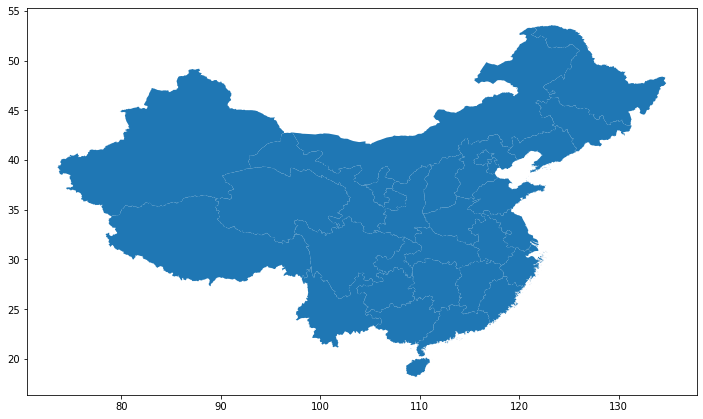

In [9]:
# reset size of the plot
f, axe = plt.subplots(1, figsize=(12, 12))
ax = prov.plot(ax=axe)
plt.show()

Now merge ncov data with current province shape file together for plotting.

In [10]:
cn = china.merge(prov, left_on="Province/State", right_on="NAME_1")
# drop duplicated column
cn = cn.drop(columns="NAME_1")

cn.head()

,Province/State,Confirmed,Suspected,Recovered,Death,GID_0,NAME_0,GID_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,geometry
0,Hubei,7153.0,0.0,169.0,249.0,CHN,China,CHN.13_1,Húběi,湖北,Shěng,Province,None,CN.HU,"POLYGON ((109.46048 29.55436, 109.45979 29.552..."
1,Zhejiang,537.0,0.0,14.0,0.0,CHN,China,CHN.31_1,Zhèjiāng,浙江,Shěng,Province,None,CN.ZJ,"MULTIPOLYGON (((120.47292 27.14514, 120.47292 ..."
2,Guangdong,436.0,0.0,10.0,0.0,CHN,China,CHN.6_1,Guǎngdōng,廣東|广东,Shěng,Province,None,CN.GD,"MULTIPOLYGON (((110.58903 20.37208, 110.58903 ..."
3,Henan,352.0,0.0,3.0,2.0,CHN,China,CHN.12_1,Hénán,河南,Shěng,Province,None,CN.HE,"POLYGON ((116.40961 33.80473, 116.40702 33.803..."
4,Hunan,332.0,0.0,3.0,0.0,CHN,China,CHN.14_1,Húnán,湖南,Shěng,Province,None,CN.HN,"POLYGON ((112.98813 24.92126, 112.98535 24.920..."


In [11]:
cn_geo = gp.GeoDataFrame(cn)

In [23]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LinearSegmentedColormap
f, ax = plt.subplots(1, figsize = (12, 12))
divider = make_axes_locatable(ax)
# cax = divider.append_axes("right", size="5%", pad=0.1)
cn_geo['Confirmed_scale']=np.zeros(len(cn_geo))
for idx in range(len(cn_geo)):
    num = cn_geo.loc[idx, 'Confirmed']
    if num == 0:
        rg = 0
    if num > 0 and num < 10:
        rg = 0.2
    if num >= 10 and num < 100:
        rg = 0.4
    if num >= 100 and num < 1000:
        rg = 0.6  
    if num >= 1000:
        rg = 0.8
    if num > 10000:
        rg = 1
    cn_geo.loc[idx, 'Confirmed_scale'] = rg
    


# plotting with labels
cn_geo['coords'] = cn_geo['geometry'].apply(lambda x: x.representative_point().coords[:])
cn_geo['coords'] = [coords[0] for coords in cn_geo['coords']]

# cn_geo.plot(figsize=(10,10), k=4, column = 'Confirmed', legend = True,  legend_kwds={'label': "Number of Confirmed"},ax=ax)

cn_geo.plot(figsize=(10,10), column = 'Confirmed_scale',ax=ax, cmap = 'OrRd')

for idx, row in cn_geo.iterrows():
    plt.annotate(s=row['Province/State'], xy=row['coords'],
                 horizontalalignment='center')

# plot without axis
# plt.gca().xaxis.set_major_locator(plt.NullLocator())
# plt.gca().yaxis.set_major_locator(plt.NullLocator())
plt.text(72,18,'Color range: \n0\n1-9\n10-99\n100-999\n1000-9999\n>10000')             

Text(72, 18, 'Color range: \n0\n1-9\n10-99\n100-999\n1000-9999\n>10000')